#   Lab Assignment Two
## Crops disease

### Group : Lone Wolf

####  Member : Yang Shen

This dataset is containing the images of 10 different crops’ leaves. For each crop, there are subfiles containing images about healthy and unhealthy leaves. The same leaf will take the photo from different angles. The main purpose of this dataset is to classify different leaves by their categories. We can know the name of the crop and whether the crop is getting the disease by analyzing the leaves photo. 

The third party who interested in this result is seeds company. They sell millions of seeds over a year. The quality of seeds is important for the company. Seeds company usually sell some anti-disease seeds in the market. But the performance of anti-disease seeds needs to keep tracking.  Farmers can upload the photos to seeds company for daily bases. The seeds company can use our method to find out the category of leaves and what disease the crops got, or crops are healthy. So that they can give advice about how to deal with sick crops to farmers. Also, they can monitor the performance of their seeds.

The performance of our model needs to be accurate in order to find out which disease is. The high true negative rate will help the company because they can save the workload on healthy crops. They do not need to send people to check for healthy crops. For the false positive rate, it does not need to be 0%. Because when the machine processes the images, if crops are sick, they will be check by a human. Because farmers need advice from a specialized person. So that if the false positive rate is around 20%, it means there will be 20% more workload for employees. I think 20% extra workload is affordable for seeds company. However, if false positive rate is high, it means that the company will mark the sick crops into healthy category. It will cause money to lose for farmers and cause the legal issue. However, if farmers upload multiple images for the same crop, only one of the images marked as sick, the whole crop will be marked as sick and send human to check. I think for real sick crops if farmer upload 10 images, one or two images are incorrectly marked as healthy and rest of images is marked as unhealthy. It is acceptable. So that I think false negative rate cannot high than 10%. The seeds company can tell farmers to upload more photos for the same crops to increase the chance to find out sick crops. I think set the minimum photo for one crop to 5 is good.


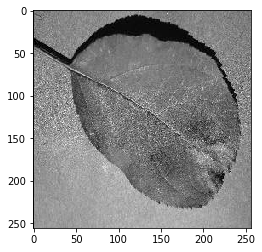

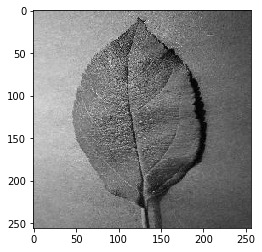

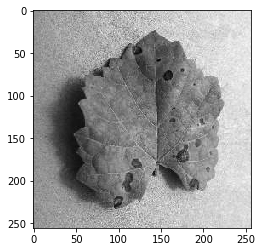

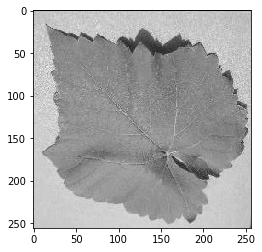

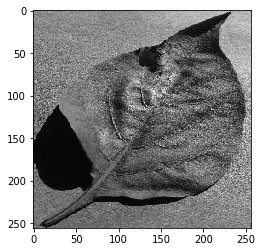

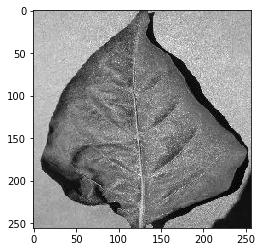

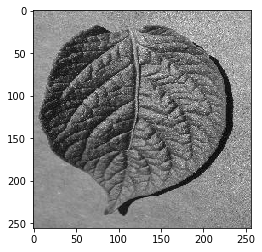

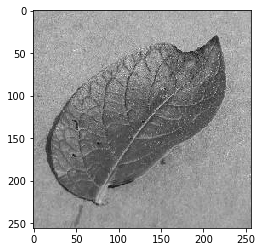

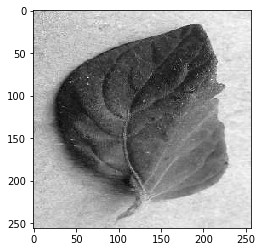

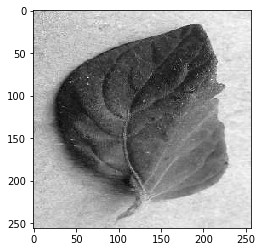

In [1]:
#https://www.youtube.com/watch?v=j-3vuBynnOE
%matplotlib inline
from matplotlib import pyplot as plt
import pandas as pd
import numpy as np
import os
import cv2
datadir = "C:/Users/jacks/Desktop/plant"
Category = ["Apple_Black_rot","Apple_healthy","Grape_Black_rot","Grape_healthy","Pepper_Bacterial_spot","Pepper_healthy","Potato_healthy","Potato_Late_blight","Tomato_Bacterial_spot","Tomato_healthy"]

for i in Category:
    path = os.path.join(datadir, i) #path to the leaf data
    for img in os.listdir(path):
        img_array = cv2.imread(os.path.join(path,img), cv2.IMREAD_GRAYSCALE)# read all the leaves file from each sub file
        plt.imshow(img_array,cmap="gray")#change to black and white images
        plt.show()
        break   #show some images not all
        

original size of the images: (256, 256)


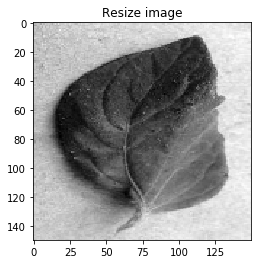

In [2]:
print('original size of the images:',img_array.shape)
print('==================================')
#show the resize of images
imagesize = 150
resize_array = cv2.resize(img_array, (imagesize,imagesize))
plt.imshow(resize_array, cmap = 'gray')
plt.title('Resize image')
plt.show()

Ther original images are 256 X 256, resize to 150 X 150 is also clear to see the image, and it will reduce the total size of array.

In [3]:
z  

In [4]:
#create the array contain the images data with 1-D image features
X = []
y = []
#seprate the 1-d images data and column values
for features, label in images:
    X.append(features)
    y.append(label)
    
names = y.copy()
#reshape the array into the correct format, which each row represent one images    
X_images = np.array(X).reshape(-1,imagesize,imagesize)
X = np.array(X_images).reshape(len(images),22500)

_, h, w = X_images.shape

In [5]:
np.array(X).shape

(4231, 22500)

In [5]:
#https://stackoverflow.com/questions/2582138/finding-and-replacing-elements-in-a-list-python
# replace the index value to the names of leaf
item_to_replace = 0
replacement_value = "Apple_Black_rot" #name of leaf
indices_to_replace = [i for i,x in enumerate(names) if x==item_to_replace]

for i in indices_to_replace:
    names[i] = replacement_value
    
item_to_replace = 1
replacement_value = "Apple_healthy"
indices_to_replace = [i for i,x in enumerate(names) if x==item_to_replace]

for i in indices_to_replace:
    names[i] = replacement_value
    
item_to_replace = 2
replacement_value = "Grape_Black_rot"
indices_to_replace = [i for i,x in enumerate(names) if x==item_to_replace]

for i in indices_to_replace:
    names[i] = replacement_value
    
item_to_replace = 3
replacement_value = "Grape_healthy"
indices_to_replace = [i for i,x in enumerate(names) if x==item_to_replace]

for i in indices_to_replace:
    names[i] = replacement_value

item_to_replace = 4
replacement_value = "Pepper_Bacterial_spot"
indices_to_replace = [i for i,x in enumerate(names) if x==item_to_replace]

for i in indices_to_replace:
    names[i] = replacement_value

item_to_replace = 5
replacement_value = "Pepper_healthy"
indices_to_replace = [i for i,x in enumerate(names) if x==item_to_replace]

for i in indices_to_replace:
    names[i] = replacement_value

item_to_replace = 6
replacement_value = "Potato_healthy"
indices_to_replace = [i for i,x in enumerate(names) if x==item_to_replace]

for i in indices_to_replace:
    names[i] = replacement_value

item_to_replace = 7
replacement_value = "Potato_Late_blight"
indices_to_replace = [i for i,x in enumerate(names) if x==item_to_replace]

for i in indices_to_replace:
    names[i] = replacement_value

item_to_replace = 8
replacement_value = "Tomato_Bacterial_spot"
indices_to_replace = [i for i,x in enumerate(names) if x==item_to_replace]

for i in indices_to_replace:
    names[i] = replacement_value

item_to_replace = 9
replacement_value = "Tomato_healthy"
indices_to_replace = [i for i,x in enumerate(names) if x==item_to_replace]

for i in indices_to_replace:
    names[i] = replacement_value


In [6]:
n_samples, n_features = X.shape
_, h, w = X_images.shape

print("n_samples: {}".format(n_samples))
print("n_features: {}".format(n_features))

print("Image Sizes {} by {}".format(h,w))
print (150*150) # the size of the images are the size of the feature vectors

n_samples: 4231
n_features: 22500
Image Sizes 150 by 150
22500


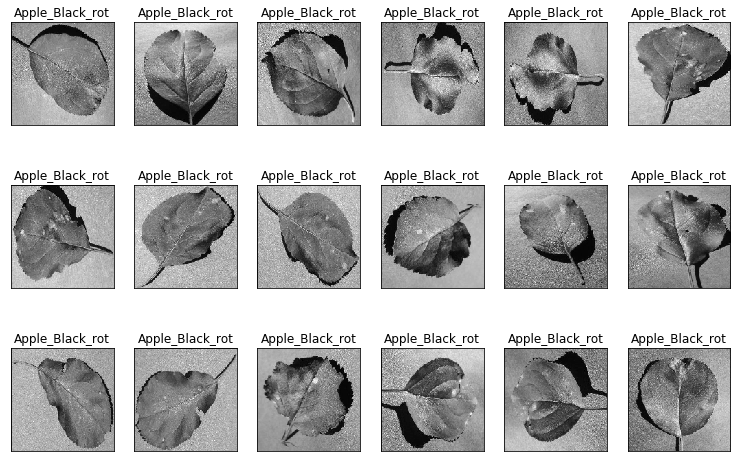

In [7]:
# a helper plotting function
#since the data read by file, here is all leaves from first file
def plot_gallery(X_images, titles, h, w, n_row=3, n_col=6):
    """Helper function to plot a gallery of portraits"""
    plt.figure(figsize=(1.7 * n_col, 2.3 * n_row))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.35)
    for i in range(n_row * n_col):
        plt.subplot(n_row, n_col, i + 1)
        plt.imshow(X_images[i].reshape((h, w)), cmap=plt.cm.gray)
        plt.title(names[i], size=12)
        plt.xticks(())
        plt.yticks(())

plot_gallery(X, names, h, w) # defaults to showing a 3 by 6 subset of the leaves

# PCA

In [8]:

from sklearn.decomposition import PCA

n_components = 500
print ("Extracting the top %d eigenleaves from %d leaves" % (
    n_components, X.shape[0]))

pca = PCA(n_components=n_components)
%time pca.fit(X.copy())
eigenleaves = pca.components_.reshape((n_components, h, w))

Extracting the top 500 eigenleaves from 4231 leaves
Wall time: 7.83 s


In [9]:
def plot_explained_variance(pca):
    import plotly
    from plotly.graph_objs import Bar, Line
    from plotly.graph_objs import Scatter, Layout
    from plotly.graph_objs.scatter import Marker
    from plotly.graph_objs.layout import XAxis, YAxis
    plotly.offline.init_notebook_mode() # run at the start of every notebook
    
    explained_var = pca.explained_variance_ratio_
    cum_var_exp = np.cumsum(explained_var)
    
    plotly.offline.iplot({
        "data": [Bar(y=explained_var, name='individual explained variance'),
                 Scatter(y=cum_var_exp, name='cumulative explained variance')
            ],
        "layout": Layout(xaxis=XAxis(title='Principal components'), yaxis=YAxis(title='Explained variance ratio'))
    })
        

pca = PCA(n_components)
X_pca = pca.fit(X)
plot_explained_variance(pca)

I do the Full PCA analysis which is Linear Reduction. Then plotting the number of components by the explained variance, I found that with 500 components, 90% of the variance will be explained.

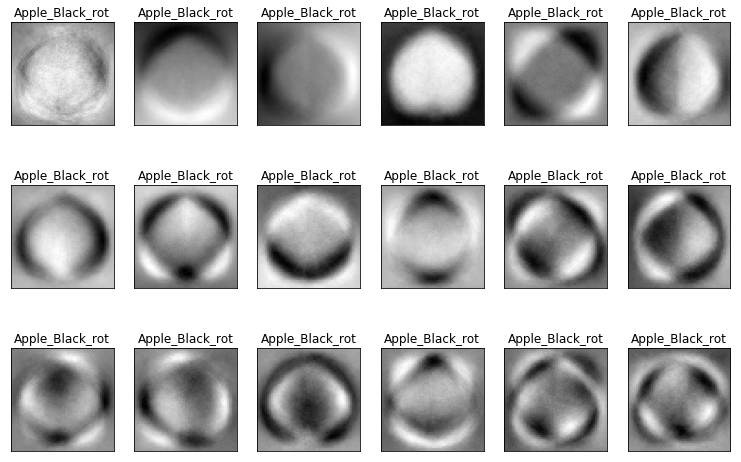

In [10]:
eigenleaves_titles = ["eigenleaves %d" % i for i in range(eigenleaves.shape[0])]
plot_gallery(eigenleaves, eigenleaves_titles, h, w)

In [11]:
def reconstruct_image(trans_obj,org_features):
    low_rep = trans_obj.transform(org_features)
    rec_image = trans_obj.inverse_transform(low_rep)
    return low_rep, rec_image


In [12]:
#https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KNeighborsClassifier.html
#use KNeighbors Classifier and build to see actual classification performance
from sklearn.neighbors import KNeighborsClassifier
low_dimensional_representation, freconstructed_image = reconstruct_image(pca,X.reshape(4231, -1))
neigh = KNeighborsClassifier(n_neighbors=3,n_jobs=-1)
neigh.fit(freconstructed_image, names) 
%time fpred = neigh.predict(freconstructed_image)


Wall time: 1min 40s


In [13]:
import numpy as np

faccuracy = 0
for i in range(len(fpred)):
    faccuracy = float(sum(fpred[i] == names[i] for i in range(len(names)))) / len(names)
    
print('accuracy of the classifier is : ',faccuracy)

accuracy of the classifier is :  0.6960529425667691


# Randomized PCA

In [10]:
n_components = 500
print ("Extracting the top %d eigenleaves from %d leaves" % (
    n_components, X.shape[0]))

rpca = PCA(n_components=n_components,svd_solver='randomized')
%time rpca.fit(X.copy())
eigenleaves = rpca.components_.reshape((n_components, h, w))

Extracting the top 500 eigenleaves from 4231 leaves
Wall time: 7.86 s


In [11]:
def plot_explained_variance(rpca):
    import plotly
    from plotly.graph_objs import Bar, Line
    from plotly.graph_objs import Scatter, Layout
    from plotly.graph_objs.scatter import Marker
    from plotly.graph_objs.layout import XAxis, YAxis
    plotly.offline.init_notebook_mode() # run at the start of every notebook
    
    explained_var = rpca.explained_variance_ratio_
    cum_var_exp = np.cumsum(explained_var)
    
    plotly.offline.iplot({
        "data": [Bar(y=explained_var, name='individual explained variance'),
                 Scatter(y=cum_var_exp, name='cumulative explained variance')
            ],
        "layout": Layout(xaxis=XAxis(title='Principal components'), yaxis=YAxis(title='Explained variance ratio'))
    })
        

rpca = PCA(n_components)
X_rpca = rpca.fit(X)
plot_explained_variance(rpca)

I do the Randomized PCA analysis which is Linear Reduction. Then plotting the number of components by the explained variance, I found that with 500 components, 90% of the variance will be explained. This result is pretty similar to the full pca result.

In [16]:
def reconstruct_image(trans_obj,org_features):
    low_rep = trans_obj.transform(org_features)
    rec_image = trans_obj.inverse_transform(low_rep)
    return low_rep, rec_image

In [17]:
#https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KNeighborsClassifier.html
from sklearn.neighbors import KNeighborsClassifier
low_dimensional_representation, rreconstructed_image = reconstruct_image(rpca,X.reshape(4231, -1))
neigh = KNeighborsClassifier(n_neighbors=3,n_jobs=-1)
neigh.fit(rreconstructed_image, names) 
%time rpred = neigh.predict(rreconstructed_image)


Wall time: 1min 38s


In [18]:
import numpy as np

raccuracy = 0
for i in range(len(rpred)):
    raccuracy = float(sum(rpred[i] == names[i] for i in range(len(names)))) / len(names)
    
print('accuracy of the classifier is : ',raccuracy)

accuracy of the classifier is :  0.69463483809974


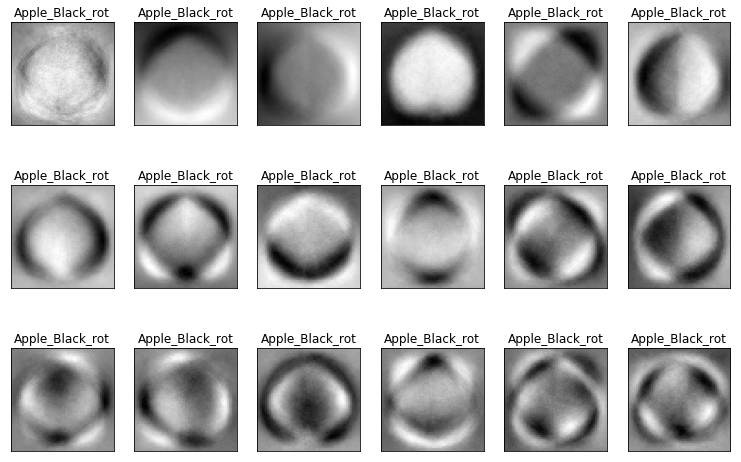

In [12]:
eigenleaves_titles = ["eigenleaves %d" % i for i in range(eigenleaves.shape[0])]
plot_gallery(eigenleaves, eigenleaves_titles, h, w)

The eigenvalues of the leaf is similar to the result from the full pca method. We will see the reconstructed images compare to each other in kernel pca plot.

# Kernel PCA

In [13]:
%%time
from sklearn.decomposition import KernelPCA

n_components = 500
print ("Extracting the top %d eigenleaves from %d leaves, ALSO getting inverse transform" % (n_components, X.shape[0]))

kpca = KernelPCA(n_components=n_components, kernel='rbf', 
                fit_inverse_transform=True, gamma=12, # very sensitive to the gamma parameter,
                remove_zero_eig=True, n_jobs=-1)  
kpca.fit(X.copy())

Extracting the top 500 eigenleaves from 4231 leaves, ALSO getting inverse transform
Wall time: 19.8 s


In [26]:
import pickle

pickle.dump(kpca, open( 'C:/Users/jacks/Desktop/plant/large_data/kpca.p', 'wb' ))


In [27]:
import pickle
kpca = pickle.load(open( 'C:/Users/jacks/Desktop/plant/large_data/kpca.p', 'rb' ))

In [21]:
def plot_explained_variance(kpca):
    import plotly
    from plotly.graph_objs import Bar, Line
    from plotly.graph_objs import Scatter, Layout
    from plotly.graph_objs.scatter import Marker
    from plotly.graph_objs.layout import XAxis, YAxis
    plotly.offline.init_notebook_mode() # run at the start of every notebook
    
    explained_var = kpca.explained_variance_ratio_
    cum_var_exp = np.cumsum(explained_var)
    
    plotly.offline.iplot({
        "data": [Bar(y=explained_var, name='individual explained variance'),
                 Scatter(y=cum_var_exp, name='cumulative explained variance')
            ],
        "layout": Layout(xaxis=XAxis(title='Principal components'), yaxis=YAxis(title='Explained variance ratio'))
    })
        

kpca = PCA(n_components)
X_kpca = kpca.fit(X)
plot_explained_variance(kpca)

I do the kernel PCA analysis which is non-Linear Reduction. Then plotting the number of components by the explained variance, I found that with 500 components, 90% of the variance will be explained. This is the same as full pca and randomized pca.

In [42]:
#https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KNeighborsClassifier.html
from sklearn.neighbors import KNeighborsClassifier
low_dimensional_representation, kreconstructed_image = reconstruct_image(kpca,X.reshape(4231, -1))
neigh = KNeighborsClassifier(n_neighbors=3,n_jobs=-1)
neigh.fit(kreconstructed_image, names) 
%time kpred = neigh.predict(kreconstructed_image)

Wall time: 1min 7s


In [43]:
import numpy as np

kaccuracy = 0
for i in range(len(kpred)):
    kaccuracy = float(sum(kpred[i] == names[i] for i in range(len(names)))) / len(names)
    
print('accuracy of the classifier is : ',kaccuracy)

accuracy of the classifier is :  0.5398251004490664


In [14]:
from ipywidgets import widgets  # make this interactive!
import warnings
# warnings.simplefilter('ignore', DeprecationWarning)
# warnings.simplefilter("always",DeprecationWarning)
def plt_reconstruct(idx_to_reconstruct):
    idx_to_reconstruct = np.round(idx_to_reconstruct)
    
    reconstructed_image = pca.inverse_transform(pca.transform(X[idx_to_reconstruct].reshape(1, -1)))
    reconstructed_image_rpca = rpca.inverse_transform(rpca.transform(X[idx_to_reconstruct].reshape(1, -1)))
    reconstructed_image_kpca = kpca.inverse_transform(kpca.transform(X[idx_to_reconstruct].reshape(1, -1)))

    
    plt.figure(figsize=(15,7))
    
    plt.subplot(1,4,1)
    plt.imshow(X[idx_to_reconstruct].reshape((h, w)), cmap=plt.cm.gray)
    plt.title(names[idx_to_reconstruct])
    plt.grid()
    
    plt.subplot(1,4,2)
    plt.imshow(reconstructed_image.reshape((h, w)), cmap=plt.cm.gray)
    plt.title('Full PCA')
    plt.grid()
    
    plt.subplot(1,4,3)
    plt.imshow(reconstructed_image_rpca.reshape((h, w)), cmap=plt.cm.gray)
    plt.title('Randomized PCA')
    plt.grid()
    
    plt.subplot(1,4,4)
    plt.imshow(reconstructed_image_kpca.reshape((h, w)), cmap=plt.cm.gray)
    plt.title('Kernel PCA')
    plt.grid()
    
    
widgets.interact(plt_reconstruct,idx_to_reconstruct=(0,n_samples-1,1),__manual=True)

interactive(children=(IntSlider(value=2115, description='idx_to_reconstruct', max=4230), Output()), _dom_class…

<function __main__.plt_reconstruct(idx_to_reconstruct)>

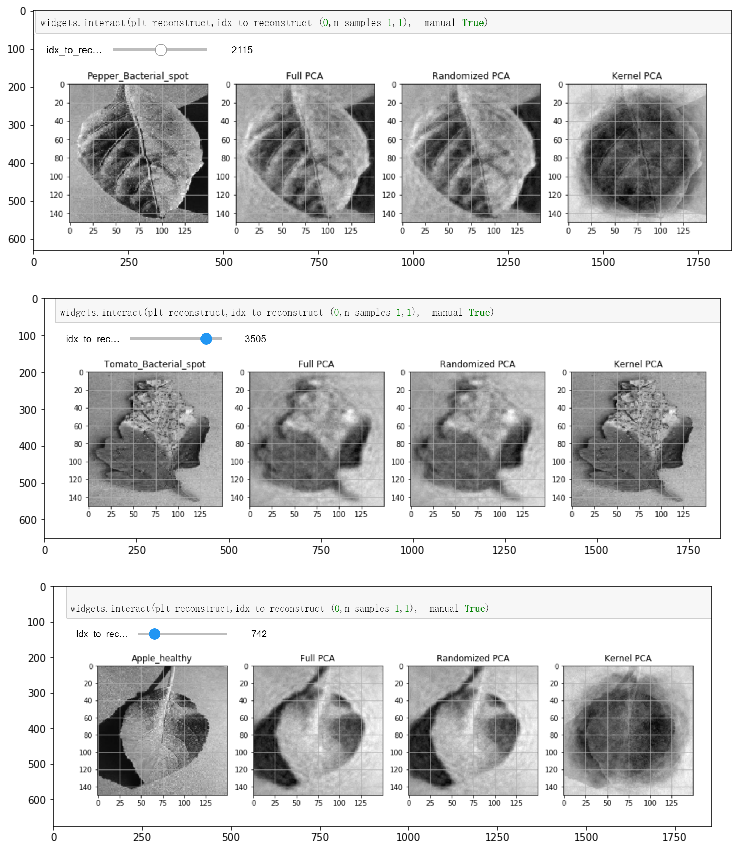

In [3]:
#screen shot because widget will not show on other computer
from PIL import Image

plt.figure(figsize=(20,15))

img = Image.open('wigpca-1.png')
plt.subplot(3,1,1)
plt.imshow(img)
img1 = Image.open('wigpca-2.png')
plt.subplot(3,1,2)
plt.imshow(img1)
plt.subplot(3,1,3)
img2 = Image.open('wigpca-3.png')
plt.imshow(img2)

After showing all the performances of three PCA method, I found that for the most images, full pca and randomized pca have pretty similar result. For Kernel PCA, sometimes it have the best performance of reflecting the original image. For the most time, kernel pca have similar result comparing to other two method. However, there are some cases that the kernel PCA performance is very bad. Just like professor talked in the class, when kernel pca do well, it does so well. When it does not, it is so bad.

In [45]:
print('Full pca accuracy of the classifier is       : ',faccuracy)
print('Randomized pca accuracy of the classifier is : ',raccuracy)
print('Kernel pcaaccuracy of the classifier is      : ',kaccuracy)

Full pca accuracy of the classifier is       :  0.6960529425667691
Randomized pca accuracy of the classifier is :  0.69463483809974
Kernel pcaaccuracy of the classifier is      :  0.5398251004490664


After comparing the accuracy for each method, the full pac and randomized have a little bit difference. I personally prefer full pca as the best method for this dataset.

# DAISY feature extraction 

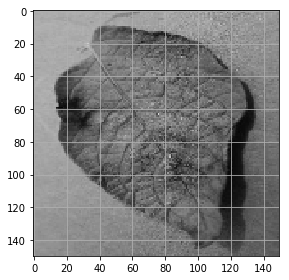

In [15]:
from skimage.io import imshow
idx_to_reconstruct = 222
idx_to_reconstruct = int(np.random.rand(1)*len(X))
img  = X[idx_to_reconstruct].reshape((h,w))
imshow(img)
plt.grid()

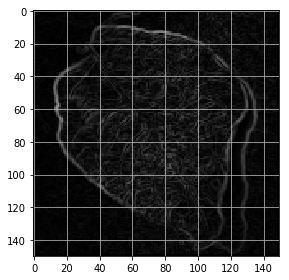

In [16]:
from skimage.filters import sobel_h, sobel_v

gradient_mag = np.sqrt(sobel_v(img)**2 + sobel_h(img)**2 ) 
imshow(gradient_mag)
plt.grid()

In [20]:
# now let's understand how to use it
from skimage.feature import daisy
features = daisy(img,step=10, radius=10, rings=2, histograms=4, orientations=8, visualize=False)
print(features.shape)
print(features.shape[0]*features.shape[1]*features.shape[2])

(13, 13, 72)
12168


In [21]:
# create a function to tak in the row of the matric and return a new feature
def apply_daisy(row,shape):
    feat = daisy(row.reshape(shape),step=10, radius=10, rings=2, histograms=6, orientations=8, visualize=False)
    return feat.reshape((-1))

In [22]:
# apply to entire data, row by row,
# takes about a minute to run
%time daisy_features = np.apply_along_axis(apply_daisy, 1, X, (h,w))
print(daisy_features.shape)

Wall time: 1min 48s
(4231, 17576)


In [23]:
from sklearn.metrics.pairwise import pairwise_distances
# find the pairwise distance between all the different image features
%time dist_matrix = pairwise_distances(daisy_features)

Wall time: 2.02 s


In [24]:
import copy
from ipywidgets import fixed
# put it together inside a nice widget
def closest_image(dmat,idx1):
    distances = copy.deepcopy(dmat[idx1,:]) # get all image diatances
    distances[idx1] = np.infty # dont pick the same image!
    idx2 = np.argmin(distances)
    
    distances[idx2] = np.infty
    idx3 = np.argmin(distances)
    
    plt.figure(figsize=(10,16))
    plt.subplot(1,3,1)
    imshow(X[idx1].reshape((h,w)))
    plt.title("Original Image "+names[idx1])
    plt.grid()

    plt.subplot(1,3,2)
    imshow(X[idx2].reshape((h,w)))
    plt.title("Closest Image  "+names[idx2])
    plt.grid()
    
    plt.subplot(1,3,3)
    imshow(X[idx3].reshape((h,w)))
    plt.title("Next Closest Image "+names[idx3])
    plt.grid()
    
widgets.interact(closest_image,idx1=(0,n_samples-1,1),dmat=fixed(dist_matrix),__manual=True)

interactive(children=(IntSlider(value=2115, description='idx1', max=4230), Output()), _dom_classes=('widget-in…

<function __main__.closest_image(dmat, idx1)>

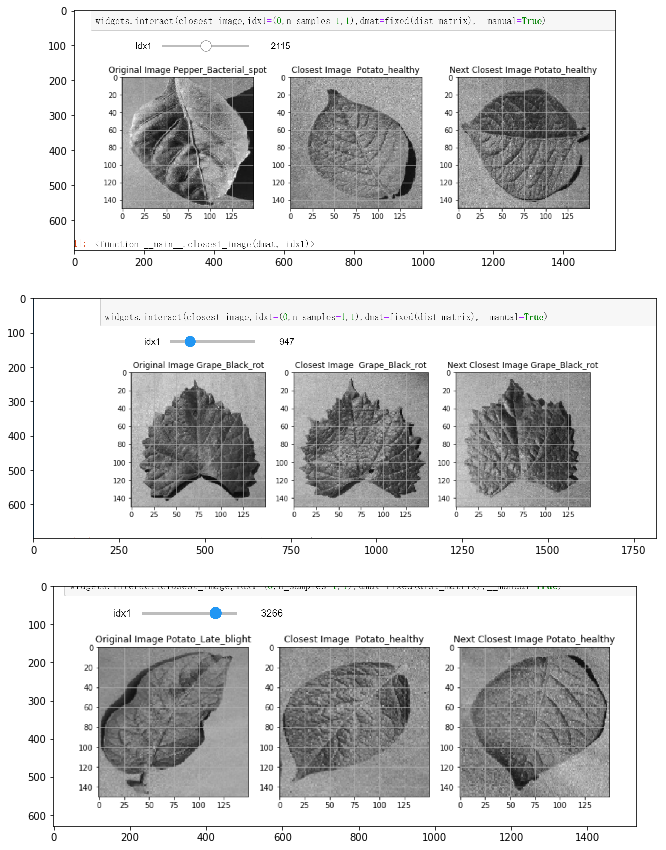

In [6]:
#screen shot because widget will not show on other computer

from PIL import Image

plt.figure(figsize=(20,15))

img = Image.open('dsy2 (2).png')
plt.subplot(3,1,1)
plt.imshow(img)
img1 = Image.open('dsy2 (1).png')
plt.subplot(3,1,2)
plt.imshow(img1)
plt.subplot(3,1,3)
img2 = Image.open('dsy3.png')
plt.imshow(img2)

We can see that for some images, it is pretty accurate. But there are some cloest images are not.

In [33]:
#https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KNeighborsClassifier.html
from sklearn.neighbors import KNeighborsClassifier
neigh = KNeighborsClassifier(n_neighbors=3,n_jobs=-1)
neigh.fit(daisy_features, names) 
%time dpred = neigh.predict(daisy_features)

Wall time: 1min 18s


In [34]:
import numpy as np

daccuracy = 0
for i in range(len(dpred)):
    daccuracy = float(sum(dpred[i] == names[i] for i in range(len(names)))) / len(names)
    
print('Daisy accuracy of the classifier is : ',daccuracy)

Daisy accuracy of the classifier is :  0.5376979437485228


The accuracy for daisy feature extraction is only 54%, which is not good enough. It does not perform well.

# key point matching

In [7]:
from skimage import data
from skimage import transform as tf
from skimage.feature import (match_descriptors, corner_harris,
                             corner_peaks, ORB, plot_matches)
from skimage.color import rgb2gray

keyimg = X.copy()
keyname = names.copy()
keyname = keyname[:400]
keyimg = keyimg[:400].reshape(400,150,150)


In [8]:
#http://answers.opencv.org/question/207758/drawkeypoints-bug/
def key_point(vis, keypoints,color = (255,0,0)):
    for i in keypoints:
        x,y = i.pt
        cv2.circle(vis,(int(x),int(y)),1,color)

In [9]:
#talked to other group about this (mumber:beicheng hu)
#https://docs.opencv.org/3.0-beta/doc/py_tutorials/py_feature2d/py_matcher/py_matcher.html
from skimage.io import imshow
from skimage import img_as_ubyte
import cv2
import numpy as np
from matplotlib import pyplot as pit 
orb = cv2.ORB_create()
idx_to_reconstruct = 0 
#http://scikit-image.org/docs/dev/api/skimage.html
#Convert an image to unsigned byte format, with values in [0, 255]
img0 = img_as_ubyte(np.array(X[idx_to_reconstruct].reshape((150,150)) ) )#reshape image, prepare for analyzing
kp0, des0 = orb.detectAndCompute(img0,None) #keypoints and descriptor
key_point(img0,kp0,color=(255,0,0)) 



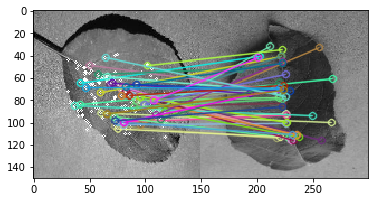

(<matplotlib.image.AxesImage at 0x284ff229d68>, None)

In [10]:
bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

#https://www.programcreek.com/python/example/89342/cv2.drawMatchesKnn
X_kp2 =[] 
X_des2 =[]   
for j in range(len(keyimg)): 
    key_point(img0,kp0,color=(255,0,0)) 
    img_j = keyimg[j] #prepare the right side of pair
    img_j = img_as_ubyte(img_j)
    kp2, des2 = orb.detectAndCompute(img_j,None) #keypoints and descriptor
    X_kp2.append(kp2)#appending all keypoints
    X_des2.append(des2) #appending all descritor
    matches = bf.match(des0, X_des2[j])
    #https://stackoverflow.com/questions/8966538/syntax-behind-sortedkey-lambda
    matches = sorted(matches, key = lambda x:x.distance)#sort the matches by distance
#https://docs.opencv.org/3.0-beta/modules/features2d/doc/drawing_function_of_keypoints_and_matches.html
    imgs = cv2.drawMatches(img0,kp0,img_j,X_kp2[j],matches,img_j, flags=2) #draw the pair keymatching plot
    #plt.imshow(imgs),plt.show()   will be 400 images for 400 pairs if running here
plt.imshow(imgs),plt.show()#only show the best match 

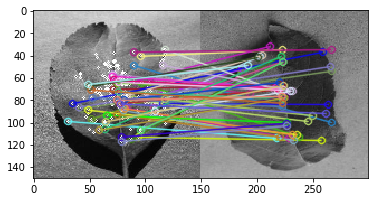

(<matplotlib.image.AxesImage at 0x284ff28f6d8>, None)

In [11]:
#show the second image with other pairs

orb = cv2.ORB_create()
idx_to_reconstruct = 1 
img0 = img_as_ubyte(np.array(X[idx_to_reconstruct].reshape((150,150)) ) )
kp0, des0 = orb.detectAndCompute(img0,None)
key_point(img0,kp0,color=(255,0,0)) 

bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
X_kp2 =[] 
X_des2 =[]        
#https://docs.opencv.org/3.0-beta/doc/py_tutorials/py_feature2d/py_matcher/py_matcher.html
#https://www.programcreek.com/python/example/89342/cv2.drawMatchesKnn
for j in range(len(keyimg)): 
    key_point(img0,kp0,color=(255,0,0)) 
    img_j = keyimg[j] 
    img_j = img_as_ubyte(img_j)
    kp2, des2 = orb.detectAndCompute(img_j,None)
    X_kp2.append(kp2)#appending all keypoints
    X_des2.append(des2) 
    matches = bf.match(des0, X_des2[j])
    #https://stackoverflow.com/questions/8966538/syntax-behind-sortedkey-lambda
    matches = sorted(matches, key = lambda x:x.distance)#sort the matches by distance
#https://docs.opencv.org/3.0-beta/modules/features2d/doc/drawing_function_of_keypoints_and_matches.html
    imgs = cv2.drawMatches(img0,kp0,img_j,X_kp2[j],matches,img_j, flags=2)
    
plt.imshow(imgs),plt.show()#only show the best match 

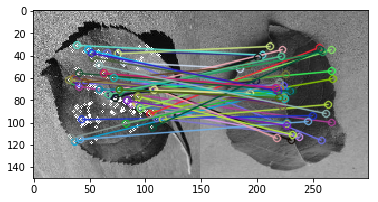

(<matplotlib.image.AxesImage at 0x284ff0ad438>, None)

In [12]:
#show the third image with other pairs

orb = cv2.ORB_create()
idx_to_reconstruct = 2 
img0 = img_as_ubyte(np.array(X[idx_to_reconstruct].reshape((150,150)) ) )
kp0, des0 = orb.detectAndCompute(img0,None)
key_point(img0,kp0,color=(255,0,0)) 

bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
X_kp2 =[] 
X_des2 =[]        
#https://docs.opencv.org/3.0-beta/doc/py_tutorials/py_feature2d/py_matcher/py_matcher.html
#https://www.programcreek.com/python/example/89342/cv2.drawMatchesKnn
for j in range(len(keyimg)): 
    key_point(img0,kp0,color=(255,0,0)) 
    img_j = keyimg[j] 
    img_j = img_as_ubyte(img_j)
    kp2, des2 = orb.detectAndCompute(img_j,None)
    X_kp2.append(kp2)#appending all keypoints
    X_des2.append(des2) 
    matches = bf.match(des0, X_des2[j])
    #https://stackoverflow.com/questions/8966538/syntax-behind-sortedkey-lambda
    matches = sorted(matches, key = lambda x:x.distance)#sort the matches by distance
#https://docs.opencv.org/3.0-beta/modules/features2d/doc/drawing_function_of_keypoints_and_matches.html
    imgs = cv2.drawMatches(img0,kp0,img_j,X_kp2[j],matches,img_j, flags=2)
    
plt.imshow(imgs),plt.show()#only show the best match